In [1]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns 
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
import xgboost as xgb
import plotly.express as px
from sklearn.metrics import mean_squared_log_error
import warnings
warnings.filterwarnings("ignore")

### Importing the datasets

In [2]:
train = pd.read_csv("train.csv")
test = pd.read_csv("test.csv")
stores = pd.read_csv("stores.csv")
transactions = pd.read_csv("transactions.csv")
holidays = pd.read_csv("holidays_events.csv")
oil = pd.read_csv("oil.csv")

### Understanding the Datasets

train.csv:
Variable | Description

store_nbr | identifies the store at which the products are sold.

family | identifies the type of product sold.

sales | gives the total sales for a product family at a particular store at a given date. Fractional values are possible since products can be sold in fractional units.

onpromotion | gives the total number of items in a product family that were being promoted at a store at a given date.

In [3]:
train

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.000,0
1,1,2013-01-01,1,BABY CARE,0.000,0
2,2,2013-01-01,1,BEAUTY,0.000,0
3,3,2013-01-01,1,BEVERAGES,0.000,0
4,4,2013-01-01,1,BOOKS,0.000,0
...,...,...,...,...,...,...
3000883,3000883,2017-08-15,9,POULTRY,438.133,0
3000884,3000884,2017-08-15,9,PREPARED FOODS,154.553,1
3000885,3000885,2017-08-15,9,PRODUCE,2419.729,148
3000886,3000886,2017-08-15,9,SCHOOL AND OFFICE SUPPLIES,121.000,8


In [4]:
train[train["store_nbr"]==1].head(10)

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0
1,1,2013-01-01,1,BABY CARE,0.0,0
2,2,2013-01-01,1,BEAUTY,0.0,0
3,3,2013-01-01,1,BEVERAGES,0.0,0
4,4,2013-01-01,1,BOOKS,0.0,0
5,5,2013-01-01,1,BREAD/BAKERY,0.0,0
6,6,2013-01-01,1,CELEBRATION,0.0,0
7,7,2013-01-01,1,CLEANING,0.0,0
8,8,2013-01-01,1,DAIRY,0.0,0
9,9,2013-01-01,1,DELI,0.0,0


In [5]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3000888 entries, 0 to 3000887
Data columns (total 6 columns):
 #   Column       Dtype  
---  ------       -----  
 0   id           int64  
 1   date         object 
 2   store_nbr    int64  
 3   family       object 
 4   sales        float64
 5   onpromotion  int64  
dtypes: float64(1), int64(3), object(2)
memory usage: 137.4+ MB


In [6]:
train['date'] = pd.to_datetime(train['date'])

In [7]:
train['year'] = train['date'].dt.year
train['month'] = train['date'].dt.month
train['day'] = train['date'].dt.day
train['day_of_week'] = train['date'].dt.dayofweek
train['weekend'] = train['day_of_week'].isin([5, 6]).astype(int)

In [8]:
train.drop('date',axis=1,inplace=True)

In [9]:
test['date'] = pd.to_datetime(test['date'])
test['year'] = test['date'].dt.year
test['month'] = test['date'].dt.month
test['day'] = test['date'].dt.day
test['day_of_week'] = test['date'].dt.dayofweek
test['weekend'] = test['day_of_week'].isin([5, 6]).astype(int) 

In [10]:
test.drop('date',axis=1,inplace=True)

In [11]:
la = LabelEncoder()
test.family = la.fit_transform(test.family)
test

,id,store_nbr,family,onpromotion,year,month,day,day_of_week,weekend
0,3000888,1,0,0,2017,8,16,2,0
1,3000889,1,1,0,2017,8,16,2,0
2,3000890,1,2,2,2017,8,16,2,0
3,3000891,1,3,20,2017,8,16,2,0
4,3000892,1,4,0,2017,8,16,2,0
...,...,...,...,...,...,...,...,...,...
28507,3029395,9,28,1,2017,8,31,3,0
28508,3029396,9,29,0,2017,8,31,3,0
28509,3029397,9,30,1,2017,8,31,3,0
28510,3029398,9,31,9,2017,8,31,3,0


In [12]:
la = LabelEncoder()
train.family = la.fit_transform(train.family)
train

,id,store_nbr,family,sales,onpromotion,year,month,day,day_of_week,weekend
0,0,1,0,0.000,0,2013,1,1,1,0
1,1,1,1,0.000,0,2013,1,1,1,0
2,2,1,2,0.000,0,2013,1,1,1,0
3,3,1,3,0.000,0,2013,1,1,1,0
4,4,1,4,0.000,0,2013,1,1,1,0
...,...,...,...,...,...,...,...,...,...,...
3000883,3000883,9,28,438.133,0,2017,8,15,1,0
3000884,3000884,9,29,154.553,1,2017,8,15,1,0
3000885,3000885,9,30,2419.729,148,2017,8,15,1,0
3000886,3000886,9,31,121.000,8,2017,8,15,1,0


In [13]:
# there is no any missing data
train.isna().sum()

id             0
store_nbr      0
family         0
sales          0
onpromotion    0
year           0
month          0
day            0
day_of_week    0
weekend        0
dtype: int64

In [14]:
# let us look at the data if is there any duplicated data
train[train.duplicated()].head()


,id,store_nbr,family,sales,onpromotion,year,month,day,day_of_week,weekend


#### test.csv:
The test data, having the same features as the training data. You will predict the target sales for the dates in this file.
The dates in the test data are for the 15 days after the last date in the training data.

In [15]:
test.head()

,id,store_nbr,family,onpromotion,year,month,day,day_of_week,weekend
0,3000888,1,0,0,2017,8,16,2,0
1,3000889,1,1,0,2017,8,16,2,0
2,3000890,1,2,2,2017,8,16,2,0
3,3000891,1,3,20,2017,8,16,2,0
4,3000892,1,4,0,2017,8,16,2,0


In [16]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28512 entries, 0 to 28511
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype
---  ------       --------------  -----
 0   id           28512 non-null  int64
 1   store_nbr    28512 non-null  int64
 2   family       28512 non-null  int32
 3   onpromotion  28512 non-null  int64
 4   year         28512 non-null  int64
 5   month        28512 non-null  int64
 6   day          28512 non-null  int64
 7   day_of_week  28512 non-null  int64
 8   weekend      28512 non-null  int32
dtypes: int32(2), int64(7)
memory usage: 1.7 MB


In [17]:
# there is no any missing data
test.isna().sum()

id             0
store_nbr      0
family         0
onpromotion    0
year           0
month          0
day            0
day_of_week    0
weekend        0
dtype: int64

In [18]:
# let us look at the data if is there any duplicated data
test[test.duplicated()].head()


,id,store_nbr,family,onpromotion,year,month,day,day_of_week,weekend


#### stores.csv:
Store metadata, including city, state, type, and cluster. cluster is a grouping of similar stores.

In [19]:
stores.head()

,store_nbr,city,state,type,cluster
0,1,Quito,Pichincha,D,13
1,2,Quito,Pichincha,D,13
2,3,Quito,Pichincha,D,8
3,4,Quito,Pichincha,D,9
4,5,Santo Domingo,Santo Domingo de los Tsachilas,D,4


In [20]:
stores.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54 entries, 0 to 53
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   store_nbr  54 non-null     int64 
 1   city       54 non-null     object
 2   state      54 non-null     object
 3   type       54 non-null     object
 4   cluster    54 non-null     int64 
dtypes: int64(2), object(3)
memory usage: 2.2+ KB


In [21]:
# let us look at the data if is there any duplicated data
stores[stores.duplicated()].head()

,store_nbr,city,state,type,cluster


#### oil.csv:
Daily oil price. Includes values during both the train and test data timeframes. (Ecuador is an oil-dependent country and it's economical health is highly vulnerable to shocks in oil prices.

In [22]:
oil.head()

,date,dcoilwtico
0,2013-01-01,NaN
1,2013-01-02,93.14
2,2013-01-03,92.97
3,2013-01-04,93.12
4,2013-01-07,93.20


In [23]:
oil.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1218 entries, 0 to 1217
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   date        1218 non-null   object 
 1   dcoilwtico  1175 non-null   float64
dtypes: float64(1), object(1)
memory usage: 19.2+ KB


In [24]:
oil["date"]=pd.to_datetime(oil["date"])

In [25]:
oil.isna().sum()

date           0
dcoilwtico    43
dtype: int64

There are some missing data points in the daily oil data as you can see below. You can treat the data by using various imputation methods. However, I chose a simple solution for that. Linear Interpolation is suitable for this time serie. You can see the trend and predict missing data points, when you look at a time serie plot of oil price.

In [26]:
# Resample
oil_date_index = oil.set_index("date").dcoilwtico.resample("D").mean().reset_index()
# Interpolate
oil_date_index["dcoilwtico"] = np.where(oil_date_index["dcoilwtico"] == 0, np.nan, oil_date_index["dcoilwtico"])
oil_date_index["dcoilwtico_interpolated"] =oil_date_index.dcoilwtico.interpolate()
# Plot
p = oil_date_index.melt(id_vars=['date']+list(oil_date_index.keys()[5:]), var_name='Legend')
px.line(p.sort_values(["Legend", "date"], ascending = [False, True]), x='date', y='value', color='Legend',title = "Daily Oil Price" )

#### Lag features
To make a lag feature we shift the observations of the target series so that they appear to have occured later in time. Here we've created a 1-step lag feature, though shifting by multiple steps is possible too. I will try to fill the missing data of the oil table by using lag features if it works well.

In [27]:
oil["lag_1"]=oil["dcoilwtico"].shift(1)
oil.head()

,date,dcoilwtico,lag_1
0,2013-01-01,NaN,NaN
1,2013-01-02,93.14,NaN
2,2013-01-03,92.97,93.14
3,2013-01-04,93.12,92.97
4,2013-01-07,93.20,93.12


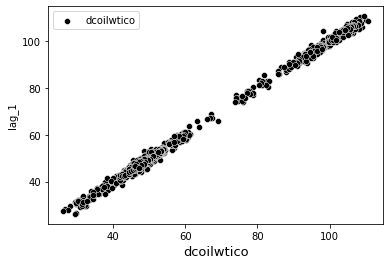

In [28]:
ax=sns.scatterplot(x="dcoilwtico",
                y="lag_1",
                data=oil,
                label="dcoilwtico",
                color="black"
               )

ax.set_xlabel("dcoilwtico",fontsize=13)
plt.legend()
plt.show()

In [29]:
from scipy.stats import spearmanr

oid_without_missing=oil.dropna()
spearman_correlation,_=spearmanr(oid_without_missing["dcoilwtico"],oid_without_missing["lag_1"])
print(f"the correlation between dcoilwtico anb a 1-step lag feature is :{np.round(spearman_correlation,4)}")

the correlation between dcoilwtico anb a 1-step lag feature is :0.9928


In [30]:
# now I will fill the missing data with the previous data of the column
# I will do that if the 1 step previous value wasn't missing i will take it to fill the blank if not i will continue searching in the prebious values 
# till find not missing values
def fill_oil_previous(data,col):
    try:
        col_copy=data[col].values.tolist()
        length=data[col].shape[0]
        for i in range(length):
            if np.isnan(col_copy[i]):
                index=i-1
                while True:
                    if not np.isnan(col_copy[index]):
                        col_copy[i]=col_copy[index]
                        break
                    index-=1
            else:
                pass
        return col_copy
    except:
        print("There is no column name in the data such the column name you gave us")

liste=fill_oil_previous(oil,"dcoilwtico")

In [31]:
oil["dcoilwtico"]=liste
oil.head()

,date,dcoilwtico,lag_1
0,2013-01-01,47.26,NaN
1,2013-01-02,93.14,NaN
2,2013-01-03,92.97,93.14
3,2013-01-04,93.12,92.97
4,2013-01-07,93.20,93.12


In [32]:
# not i can drop lag_1 feature
oil.drop("lag_1",axis=1,inplace=True)
oil.head()

,date,dcoilwtico
0,2013-01-01,47.26
1,2013-01-02,93.14
2,2013-01-03,92.97
3,2013-01-04,93.12
4,2013-01-07,93.20


In [33]:
oil.iloc[0,1]=oil.iloc[1,1]

#### holidays_events.csv :
Holidays and Events, with metadata


In [34]:
holidays.head()

,date,type,locale,locale_name,description,transferred
0,2012-03-02,Holiday,Local,Manta,Fundacion de Manta,False
1,2012-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi,False
2,2012-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,False
3,2012-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad,False
4,2012-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba,False


In [35]:
# Additional Holidays
holidays["description"] = holidays["description"].str.replace("-", "").str.replace("+", "").str.replace('\d+', '')
holidays["type"] = np.where(holidays["type"] == "Additional", "Holiday", holidays["type"])

# Bridge Holidays
holidays["description"] = holidays["description"].str.replace("Puente ", "")
holidays["type"] = np.where(holidays["type"] == "Bridge", "Holiday", holidays["type"])

In [36]:
holidays.type.unique()

array(['Holiday', 'Transfer', 'Work Day', 'Event'], dtype=object)

In [37]:
holidays[holidays.duplicated()]

,date,type,locale,locale_name,description,transferred
36,2012-12-24,Holiday,National,Ecuador,Navidad,False
40,2012-12-31,Holiday,National,Ecuador,Primer dia del ano,False
157,2014-12-26,Holiday,National,Ecuador,Navidad,False


In [38]:
holidays.drop_duplicates(inplace=True)

In [39]:
holidays.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 347 entries, 0 to 349
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   date         347 non-null    object
 1   type         347 non-null    object
 2   locale       347 non-null    object
 3   locale_name  347 non-null    object
 4   description  347 non-null    object
 5   transferred  347 non-null    bool  
dtypes: bool(1), object(5)
memory usage: 16.6+ KB


In [40]:
holidays["date"]=pd.to_datetime(holidays["date"])

In [41]:
holidays.rename(columns={"type":"type_holiday"},inplace=True)

In [42]:
# Transferred Holidays
tr2=holidays[holidays.type_holiday=="Transfer"]
tr2

,date,type_holiday,locale,locale_name,description,transferred
20,2012-10-12,Transfer,National,Ecuador,Traslado Independencia de Guayaquil,False
73,2013-10-11,Transfer,National,Ecuador,Traslado Independencia de Guayaquil,False
136,2014-10-10,Transfer,National,Ecuador,Traslado Independencia de Guayaquil,False
256,2016-05-27,Transfer,National,Ecuador,Traslado Batalla de Pichincha,False
265,2016-07-24,Transfer,Local,Guayaquil,Traslado Fundacion de Guayaquil,False
269,2016-08-12,Transfer,National,Ecuador,Traslado Primer Grito de Independencia,False
298,2017-01-02,Transfer,National,Ecuador,Traslado Primer dia del ano,False
304,2017-04-13,Transfer,Local,Cuenca,Fundacion de Cuenca,False
313,2017-05-26,Transfer,National,Ecuador,Traslado Batalla de Pichincha,False
325,2017-08-11,Transfer,National,Ecuador,Traslado Primer Grito de Independencia,False


In [43]:
# A transferred day is more like a normal day than a holiday
tr1=holidays[holidays.transferred]
tr1

,date,type_holiday,locale,locale_name,description,transferred
19,2012-10-09,Holiday,National,Ecuador,Independencia de Guayaquil,True
72,2013-10-09,Holiday,National,Ecuador,Independencia de Guayaquil,True
135,2014-10-09,Holiday,National,Ecuador,Independencia de Guayaquil,True
255,2016-05-24,Holiday,National,Ecuador,Batalla de Pichincha,True
266,2016-07-25,Holiday,Local,Guayaquil,Fundacion de Guayaquil,True
268,2016-08-10,Holiday,National,Ecuador,Primer Grito de Independencia,True
297,2017-01-01,Holiday,National,Ecuador,Primer dia del ano,True
303,2017-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,True
312,2017-05-24,Holiday,National,Ecuador,Batalla de Pichincha,True
324,2017-08-10,Holiday,National,Ecuador,Primer Grito de Independencia,True


In [44]:
tr1 = tr1.drop("transferred", axis = 1).reset_index(drop = True)
tr2 = tr2.drop("transferred", axis = 1).reset_index(drop = True)
tr = pd.concat([tr1,tr2], axis = 1)
tr

,date,type_holiday,locale,locale_name,description,date,type_holiday,locale,locale_name,description
0,2012-10-09,Holiday,National,Ecuador,Independencia de Guayaquil,2012-10-12,Transfer,National,Ecuador,Traslado Independencia de Guayaquil
1,2013-10-09,Holiday,National,Ecuador,Independencia de Guayaquil,2013-10-11,Transfer,National,Ecuador,Traslado Independencia de Guayaquil
2,2014-10-09,Holiday,National,Ecuador,Independencia de Guayaquil,2014-10-10,Transfer,National,Ecuador,Traslado Independencia de Guayaquil
3,2016-05-24,Holiday,National,Ecuador,Batalla de Pichincha,2016-05-27,Transfer,National,Ecuador,Traslado Batalla de Pichincha
4,2016-07-25,Holiday,Local,Guayaquil,Fundacion de Guayaquil,2016-07-24,Transfer,Local,Guayaquil,Traslado Fundacion de Guayaquil
5,2016-08-10,Holiday,National,Ecuador,Primer Grito de Independencia,2016-08-12,Transfer,National,Ecuador,Traslado Primer Grito de Independencia
6,2017-01-01,Holiday,National,Ecuador,Primer dia del ano,2017-01-02,Transfer,National,Ecuador,Traslado Primer dia del ano
7,2017-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,2017-04-13,Transfer,Local,Cuenca,Fundacion de Cuenca
8,2017-05-24,Holiday,National,Ecuador,Batalla de Pichincha,2017-05-26,Transfer,National,Ecuador,Traslado Batalla de Pichincha
9,2017-08-10,Holiday,National,Ecuador,Primer Grito de Independencia,2017-08-11,Transfer,National,Ecuador,Traslado Primer Grito de Independencia


In [45]:
tr = tr.iloc[:, [5,1,2,3,4]]
tr

,date,type_holiday,locale,locale_name,description
0,2012-10-12,Holiday,National,Ecuador,Independencia de Guayaquil
1,2013-10-11,Holiday,National,Ecuador,Independencia de Guayaquil
2,2014-10-10,Holiday,National,Ecuador,Independencia de Guayaquil
3,2016-05-27,Holiday,National,Ecuador,Batalla de Pichincha
4,2016-07-24,Holiday,Local,Guayaquil,Fundacion de Guayaquil
5,2016-08-12,Holiday,National,Ecuador,Primer Grito de Independencia
6,2017-01-02,Holiday,National,Ecuador,Primer dia del ano
7,2017-04-13,Holiday,Local,Cuenca,Fundacion de Cuenca
8,2017-05-26,Holiday,National,Ecuador,Batalla de Pichincha
9,2017-08-11,Holiday,National,Ecuador,Primer Grito de Independencia


In [46]:
holidays=holidays[(holidays.transferred == False) & (holidays.type_holiday != "Transfer")].drop("transferred", axis = 1)
holidays.head()

,date,type_holiday,locale,locale_name,description
0,2012-03-02,Holiday,Local,Manta,Fundacion de Manta
1,2012-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi
2,2012-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca
3,2012-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad
4,2012-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba


In [47]:
holidays = pd.concat([holidays,tr],axis=0)
holidays.tail()

,date,type_holiday,locale,locale_name,description
7,2017-04-13,Holiday,Local,Cuenca,Fundacion de Cuenca
8,2017-05-26,Holiday,National,Ecuador,Batalla de Pichincha
9,2017-08-11,Holiday,National,Ecuador,Primer Grito de Independencia
10,2017-09-29,Holiday,Local,Ibarra,Fundacion de Ibarra
11,2017-12-08,Holiday,Local,Quito,Fundacion de Quito


In [48]:
work_day = holidays[holidays.type_holiday == "Work Day"]  
holidays = holidays[holidays.type_holiday != "Work Day"] 
work_day

,date,type_holiday,locale,locale_name,description
42,2013-01-05,Work Day,National,Ecuador,Recupero puente Navidad
43,2013-01-12,Work Day,National,Ecuador,Recupero puente primer dia del ano
149,2014-12-20,Work Day,National,Ecuador,Recupero Navidad
161,2015-01-10,Work Day,National,Ecuador,Recupero Primer dia del ano
283,2016-11-12,Work Day,National,Ecuador,Recupero Dia de Difuntos


In [49]:
holidays[holidays.locale == "National"].locale_name.unique()

array(['Ecuador'], dtype=object)

In [50]:
events = holidays[holidays.type_holiday == "Event"]
events.head()

,date,type_holiday,locale,locale_name,description
55,2013-05-12,Event,National,Ecuador,Dia de la Madre
103,2014-05-11,Event,National,Ecuador,Dia de la Madre
106,2014-06-12,Event,National,Ecuador,Inauguracion Mundial de futbol Brasil
107,2014-06-15,Event,National,Ecuador,Mundial de futbol Brasil: EcuadorSuiza
108,2014-06-20,Event,National,Ecuador,Mundial de futbol Brasil: EcuadorHonduras


In [51]:
print(events.type_holiday.unique())
print(events.locale.unique())
print(events.locale_name.unique())

['Event']
['National']
['Ecuador']


In [52]:
# Filter events and simplify description
events = holidays[holidays.type_holiday == "Event"]
events = events.drop(["type_holiday", "locale", "locale_name"], axis=1)
events["events"] = np.where(events["description"].str.contains("futbol"), "Futbol", events["description"])

# Filter and process regional holidays
regional = holidays[holidays.locale == "Regional"]
regional = regional.rename(columns={"locale_name": "state", "description": "holiday_regional"})
regional = regional.drop(["locale", "type_holiday"], axis=1).drop_duplicates()

# Filter and process national holidays
national = holidays[holidays.locale == "National"]
national = national.rename(columns={"description": "holiday_national"})
national = national.drop(["locale", "locale_name", "type_holiday"], axis=1).drop_duplicates()

# Filter and process local holidays
local = holidays[holidays.locale == "Local"]
local = local.rename(columns={"locale_name": "city", "description": "holiday_local"})
local = local.drop(["locale", "type_holiday"], axis=1).drop_duplicates()



In [53]:
local.head()

,date,city,holiday_local
0,2012-03-02,Manta,Fundacion de Manta
2,2012-04-12,Cuenca,Fundacion de Cuenca
3,2012-04-14,Libertad,Cantonizacion de Libertad
4,2012-04-21,Riobamba,Cantonizacion de Riobamba
5,2012-05-12,Puyo,Cantonizacion del Puyo


In [54]:
national.tail()

,date,holiday_national
3,2016-05-27,Batalla de Pichincha
5,2016-08-12,Primer Grito de Independencia
6,2017-01-02,Primer dia del ano
8,2017-05-26,Batalla de Pichincha
9,2017-08-11,Primer Grito de Independencia


In [55]:
regional.head()

,date,state,holiday_regional
1,2012-04-01,Cotopaxi,Provincializacion de Cotopaxi
7,2012-06-25,Imbabura,Provincializacion de Imbabura
23,2012-11-06,Santo Domingo de los Tsachilas,Provincializacion de Santo Domingo
24,2012-11-07,Santa Elena,Provincializacion Santa Elena
47,2013-04-01,Cotopaxi,Provincializacion de Cotopaxi


In [56]:
# National Holidays & Events
#d = pd.merge(holidays, events, how = "left")
holidays = pd.merge(holidays, national, how = "left")
# Regional
holidays = pd.merge(holidays, regional, how = "left")
# Local
holidays = pd.merge(holidays, local, how = "left")

# Work Day: It will be removed when real work day colum created
holidays = pd.merge(holidays,  work_day[["date", "type_holiday"]].rename(columns={"type_holiday":"IsWorkDay"}),how = "left")

In [57]:
holidays.drop(["locale","locale_name","description"],axis=1,inplace=True)
holidays.head()

,date,type_holiday,holiday_national,state,holiday_regional,city,holiday_local,IsWorkDay
0,2012-03-02,Holiday,NaN,NaN,NaN,Manta,Fundacion de Manta,NaN
1,2012-04-01,Holiday,NaN,Cotopaxi,Provincializacion de Cotopaxi,NaN,NaN,NaN
2,2012-04-12,Holiday,NaN,NaN,NaN,Cuenca,Fundacion de Cuenca,NaN
3,2012-04-14,Holiday,NaN,NaN,NaN,Libertad,Cantonizacion de Libertad,NaN
4,2012-04-21,Holiday,NaN,NaN,NaN,Riobamba,Cantonizacion de Riobamba,NaN


In [58]:
transactions=transactions.sort_values(by=["date","store_nbr"],ascending=[True,True])
transactions.tail()

,date,store_nbr,transactions
83483,2017-08-15,50,2804
83484,2017-08-15,51,1573
83485,2017-08-15,52,2255
83486,2017-08-15,53,932
83487,2017-08-15,54,802


In [59]:
transactions.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 83488 entries, 0 to 83487
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   date          83488 non-null  object
 1   store_nbr     83488 non-null  int64 
 2   transactions  83488 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 2.5+ MB


In [60]:
transactions["date"]=pd.to_datetime(transactions["date"])

### Merging the Train Data

In [61]:
train_set=train.merge(stores,how="left")
train_set.head()

,id,store_nbr,family,sales,onpromotion,year,month,day,day_of_week,weekend,city,state,type,cluster
0,0,1,0,0.0,0,2013,1,1,1,0,Quito,Pichincha,D,13
1,1,1,1,0.0,0,2013,1,1,1,0,Quito,Pichincha,D,13
2,2,1,2,0.0,0,2013,1,1,1,0,Quito,Pichincha,D,13
3,3,1,3,0.0,0,2013,1,1,1,0,Quito,Pichincha,D,13
4,4,1,4,0.0,0,2013,1,1,1,0,Quito,Pichincha,D,13


In [62]:
print(train_set.shape)

(3000888, 14)


In [63]:
train_set['date'] = pd.to_datetime(train_set[['year', 'month', 'day']])


In [64]:
# National Holidays & Events
train_set = pd.merge(train_set, national, how="left", on="date")
# Regional
train_set = pd.merge(train_set, regional, how="left", on=["date", "state"])
# Local
train_set = pd.merge(train_set, local, how="left", on=["date", "city"])

# Work Day: It will be removed when real work day colum created
train_set = pd.merge(train_set, work_day[["date", "type_holiday"]].rename(columns={"type_holiday": "IsWorkDay"}), how="left", on="date")


In [65]:
train_set=train_set.merge(oil,how="left")
train_set.head()

,id,store_nbr,family,sales,onpromotion,year,month,day,day_of_week,weekend,city,state,type,cluster,date,holiday_national,holiday_regional,holiday_local,IsWorkDay,dcoilwtico
0,0,1,0,0.0,0,2013,1,1,1,0,Quito,Pichincha,D,13,2013-01-01,Primer dia del ano,NaN,NaN,NaN,93.14
1,1,1,1,0.0,0,2013,1,1,1,0,Quito,Pichincha,D,13,2013-01-01,Primer dia del ano,NaN,NaN,NaN,93.14
2,2,1,2,0.0,0,2013,1,1,1,0,Quito,Pichincha,D,13,2013-01-01,Primer dia del ano,NaN,NaN,NaN,93.14
3,3,1,3,0.0,0,2013,1,1,1,0,Quito,Pichincha,D,13,2013-01-01,Primer dia del ano,NaN,NaN,NaN,93.14
4,4,1,4,0.0,0,2013,1,1,1,0,Quito,Pichincha,D,13,2013-01-01,Primer dia del ano,NaN,NaN,NaN,93.14


In [66]:
print(train_set.shape)

(3006234, 20)


In [67]:
train_set=train_set.merge(transactions,how="left")
train_set.head()

,id,store_nbr,family,sales,onpromotion,year,month,day,day_of_week,weekend,...,state,type,cluster,date,holiday_national,holiday_regional,holiday_local,IsWorkDay,dcoilwtico,transactions
0,0,1,0,0.0,0,2013,1,1,1,0,...,Pichincha,D,13,2013-01-01,Primer dia del ano,NaN,NaN,NaN,93.14,NaN
1,1,1,1,0.0,0,2013,1,1,1,0,...,Pichincha,D,13,2013-01-01,Primer dia del ano,NaN,NaN,NaN,93.14,NaN
2,2,1,2,0.0,0,2013,1,1,1,0,...,Pichincha,D,13,2013-01-01,Primer dia del ano,NaN,NaN,NaN,93.14,NaN
3,3,1,3,0.0,0,2013,1,1,1,0,...,Pichincha,D,13,2013-01-01,Primer dia del ano,NaN,NaN,NaN,93.14,NaN
4,4,1,4,0.0,0,2013,1,1,1,0,...,Pichincha,D,13,2013-01-01,Primer dia del ano,NaN,NaN,NaN,93.14,NaN


### Merging the Test Data

In [68]:
test_set=test.merge(stores,how="left")
test_set.head()

,id,store_nbr,family,onpromotion,year,month,day,day_of_week,weekend,city,state,type,cluster
0,3000888,1,0,0,2017,8,16,2,0,Quito,Pichincha,D,13
1,3000889,1,1,0,2017,8,16,2,0,Quito,Pichincha,D,13
2,3000890,1,2,2,2017,8,16,2,0,Quito,Pichincha,D,13
3,3000891,1,3,20,2017,8,16,2,0,Quito,Pichincha,D,13
4,3000892,1,4,0,2017,8,16,2,0,Quito,Pichincha,D,13


In [69]:
test_set['date'] = pd.to_datetime(test_set[['year', 'month', 'day']])

In [70]:
# National Holidays & Events
test_set = pd.merge(test_set, national, how = "left")
# Regional
test_set = pd.merge(test_set, regional, how = "left", on = ["date", "state"])
# Local
test_set = pd.merge(test_set, local, how = "left",on = ["date", "city"])

# Work Day: It will be removed when real work day colum created
test_set = pd.merge(test_set,  work_day[["date", "type_holiday"]].rename(columns={"type_holiday":"IsWorkDay"}),how = "left")
test_set.head()

,id,store_nbr,family,onpromotion,year,month,day,day_of_week,weekend,city,state,type,cluster,date,holiday_national,holiday_regional,holiday_local,IsWorkDay
0,3000888,1,0,0,2017,8,16,2,0,Quito,Pichincha,D,13,2017-08-16,NaN,NaN,NaN,NaN
1,3000889,1,1,0,2017,8,16,2,0,Quito,Pichincha,D,13,2017-08-16,NaN,NaN,NaN,NaN
2,3000890,1,2,2,2017,8,16,2,0,Quito,Pichincha,D,13,2017-08-16,NaN,NaN,NaN,NaN
3,3000891,1,3,20,2017,8,16,2,0,Quito,Pichincha,D,13,2017-08-16,NaN,NaN,NaN,NaN
4,3000892,1,4,0,2017,8,16,2,0,Quito,Pichincha,D,13,2017-08-16,NaN,NaN,NaN,NaN


In [71]:
test_set=test_set.merge(oil,how="left")
test_set.head()

,id,store_nbr,family,onpromotion,year,month,day,day_of_week,weekend,city,state,type,cluster,date,holiday_national,holiday_regional,holiday_local,IsWorkDay,dcoilwtico
0,3000888,1,0,0,2017,8,16,2,0,Quito,Pichincha,D,13,2017-08-16,NaN,NaN,NaN,NaN,46.8
1,3000889,1,1,0,2017,8,16,2,0,Quito,Pichincha,D,13,2017-08-16,NaN,NaN,NaN,NaN,46.8
2,3000890,1,2,2,2017,8,16,2,0,Quito,Pichincha,D,13,2017-08-16,NaN,NaN,NaN,NaN,46.8
3,3000891,1,3,20,2017,8,16,2,0,Quito,Pichincha,D,13,2017-08-16,NaN,NaN,NaN,NaN,46.8
4,3000892,1,4,0,2017,8,16,2,0,Quito,Pichincha,D,13,2017-08-16,NaN,NaN,NaN,NaN,46.8


In [72]:
test_set=test_set.merge(transactions,how="left")
test_set.head()

,id,store_nbr,family,onpromotion,year,month,day,day_of_week,weekend,city,state,type,cluster,date,holiday_national,holiday_regional,holiday_local,IsWorkDay,dcoilwtico,transactions
0,3000888,1,0,0,2017,8,16,2,0,Quito,Pichincha,D,13,2017-08-16,NaN,NaN,NaN,NaN,46.8,NaN
1,3000889,1,1,0,2017,8,16,2,0,Quito,Pichincha,D,13,2017-08-16,NaN,NaN,NaN,NaN,46.8,NaN
2,3000890,1,2,2,2017,8,16,2,0,Quito,Pichincha,D,13,2017-08-16,NaN,NaN,NaN,NaN,46.8,NaN
3,3000891,1,3,20,2017,8,16,2,0,Quito,Pichincha,D,13,2017-08-16,NaN,NaN,NaN,NaN,46.8,NaN
4,3000892,1,4,0,2017,8,16,2,0,Quito,Pichincha,D,13,2017-08-16,NaN,NaN,NaN,NaN,46.8,NaN


### Cleaning the DataSet

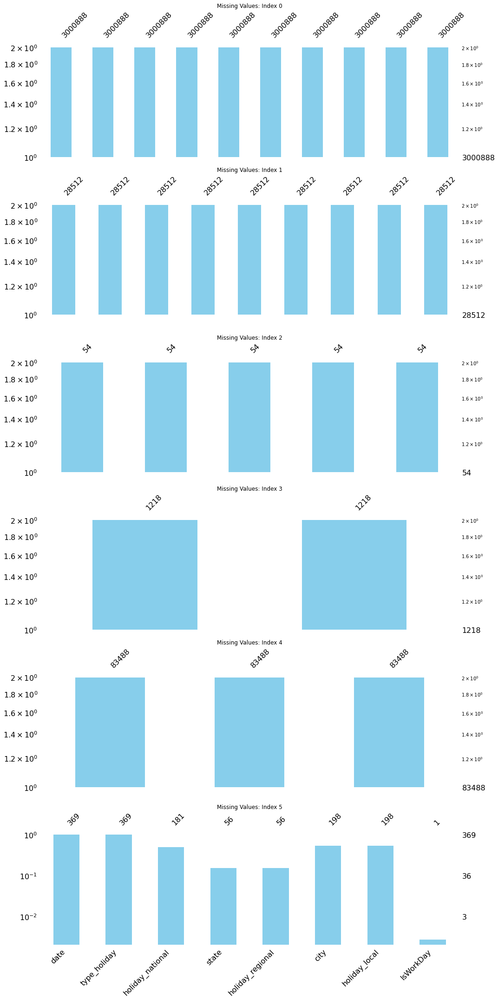

In [76]:
import missingno as msno
import matplotlib.pyplot as plt

list_data_sets=[train,test,stores,oil,transactions,holidays]

# Create a figure and axes for subplots
fig, axes = plt.subplots(len(list_data_sets), 1, figsize=(15, 5*len(list_data_sets)))

# Iterate over each DataFrame and its corresponding axis
for i, df in enumerate(list_data_sets):
    # Use missingno's bar function to visualize missing values
    msno.bar(df, ax=axes[i], color='skyblue', log=True)
    axes[i].set_title(f'Missing Values: Index {i}')

# Adjust layout
plt.tight_layout()
plt.show()



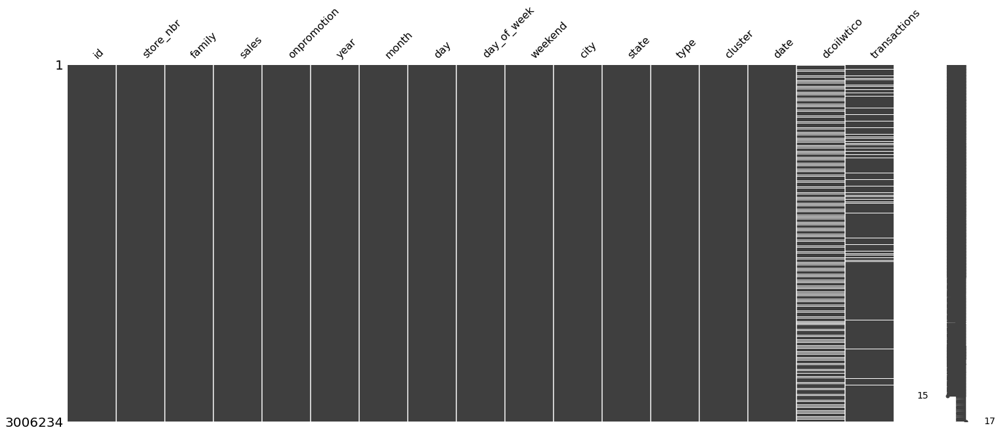

In [77]:
msno.matrix(train_set)
plt.show()

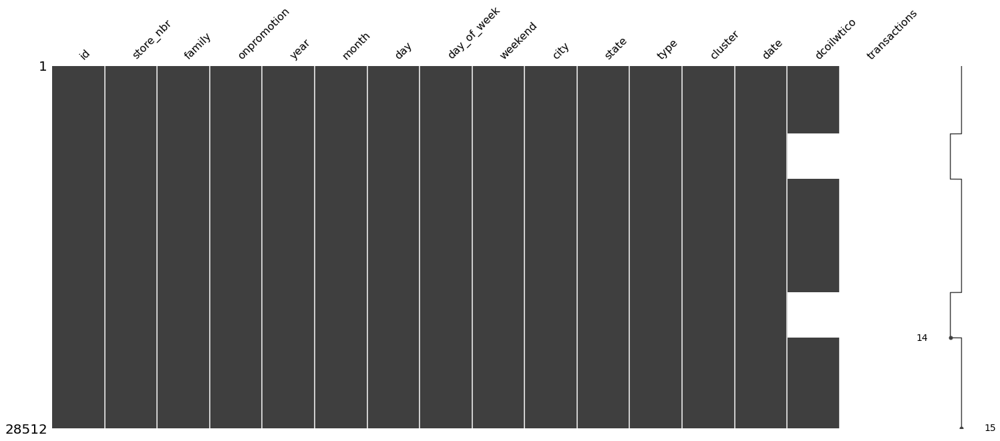

In [78]:
msno.matrix(test_set)
plt.show()

In [79]:
train_set.drop(["id"],axis=1,inplace=True)
test_set.drop(["id"],axis=1,inplace=True)

In [80]:
liste=fill_oil_previous(train_set,"dcoilwtico")
print("finding the previous values of dcoilwtico column is done")

finding the previous values of dcoilwtico column is done


In [81]:
train_set["dcoilwtico"]=liste
liste=fill_oil_previous(test_set,"dcoilwtico")
print("finding the previous values of dcoilwtico column is done")

finding the previous values of dcoilwtico column is done


In [82]:
test_set["dcoilwtico"]=liste
train_set.columns

Index(['store_nbr', 'family', 'sales', 'onpromotion', 'year', 'month', 'day',
       'day_of_week', 'weekend', 'city', 'state', 'type', 'cluster', 'date',
       'dcoilwtico', 'transactions'],
      dtype='object')

### Exploratory Data Analysis

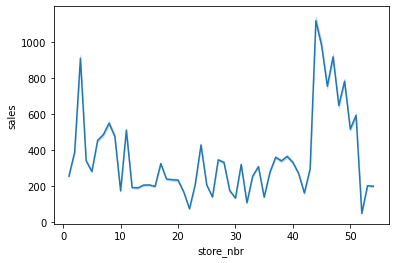

In [114]:
sns.lineplot(x="store_nbr", y="sales", data=train)

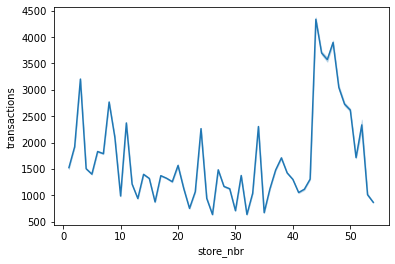

In [115]:
sns.lineplot(x = "store_nbr", y = "transactions", data = transactions)

In [84]:
oil["year"]=oil.date.dt.year
oil.head()

,date,dcoilwtico,year
0,2013-01-01,93.14,2013
1,2013-01-02,93.14,2013
2,2013-01-03,92.97,2013
3,2013-01-04,93.12,2013
4,2013-01-07,93.20,2013


In [85]:
px.line(data_frame=oil,
        x="date",
        y="dcoilwtico",
        color="year"
       )

In [93]:
train['date'] = pd.to_datetime(train[['year', 'month', 'day']])

Correlation with Daily Oil Prices
sales          -0.317855
transactions    0.038022
Name: dcoilwtico, dtype: float64 



Text(0.5, 1.0, 'Daily Oil Price & Sales')

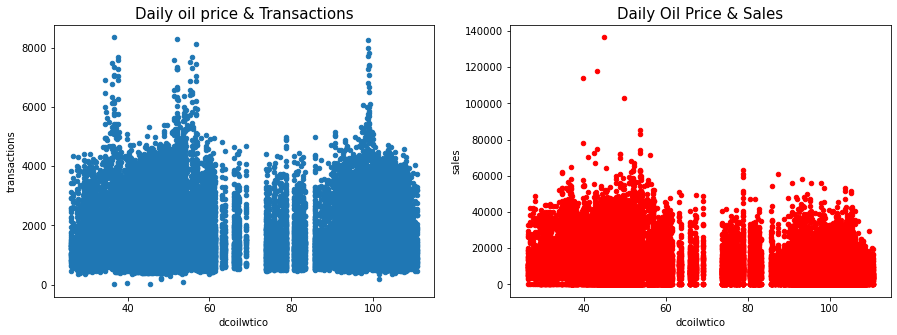

In [117]:
temp = pd.merge(train.groupby(["date", "store_nbr"]).sales.sum().reset_index(), 
                transactions,
                how="left"
               )
temp = pd.merge(temp, oil, how="left")
print("Correlation with Daily Oil Prices")
print(temp[["sales","dcoilwtico","transactions"]].corr("spearman").dcoilwtico.loc[["sales", "transactions"]], "\n")

fig, axes = plt.subplots(1, 2, figsize=(15, 5))
temp.plot.scatter(x="dcoilwtico", y="transactions", ax=axes[0])
temp.plot.scatter(x="dcoilwtico", y="sales", ax=axes[1], color="r")
axes[0].set_title('Daily oil price & Transactions', fontsize=15)
axes[1].set_title('Daily Oil Price & Sales', fontsize=15)


In [95]:
numerical_describe = train_set.describe(include=[np.number]).T
numerical_describe

,count,mean,std,min,25%,50%,75%,max
store_nbr,3006234.0,27.500000,15.585787,1.00,14.00,27.50,41.00,54.00
family,3006234.0,16.000000,9.521906,0.00,8.00,16.00,24.00,32.00
sales,3006234.0,358.191375,1103.324713,0.00,0.00,11.00,196.00,124717.00
onpromotion,3006234.0,2.609266,12.264593,0.00,0.00,0.00,0.00,741.00
year,3006234.0,2014.839953,1.345212,2013.00,2014.00,2015.00,2016.00,2017.00
month,3006234.0,6.205691,3.383039,1.00,3.00,6.00,9.00,12.00
day,3006234.0,15.611737,8.798634,1.00,8.00,16.00,23.00,31.00
day_of_week,3006234.0,3.001778,2.002221,0.00,1.00,3.00,5.00,6.00
weekend,3006234.0,0.286900,0.452314,0.00,0.00,0.00,1.00,1.00
cluster,3006234.0,8.481481,4.649735,1.00,4.00,8.50,13.00,17.00


In [96]:
categorical_describe = train_set.describe(exclude=[np.number]).T
categorical_describe

,count,unique,top,freq,first,last
city,3006234,22,Quito,1002078,NaT,NaT
state,3006234,16,Pichincha,1057749,NaT,NaT
type,3006234,5,D,1002078,NaT,NaT
date,3006234,1684,2016-05-07 00:00:00,3564,2013-01-01,2017-08-15


In [97]:
stores.shape

(54, 5)

In [98]:
stores["city"].value_counts()

Quito            18
Guayaquil         8
Santo Domingo     3
Cuenca            3
Machala           2
Manta             2
Latacunga         2
Ambato            2
Playas            1
Riobamba          1
Salinas           1
Babahoyo          1
El Carmen         1
Cayambe           1
Daule             1
Loja              1
Libertad          1
Guaranda          1
Esmeraldas        1
Quevedo           1
Puyo              1
Ibarra            1
Name: city, dtype: int64

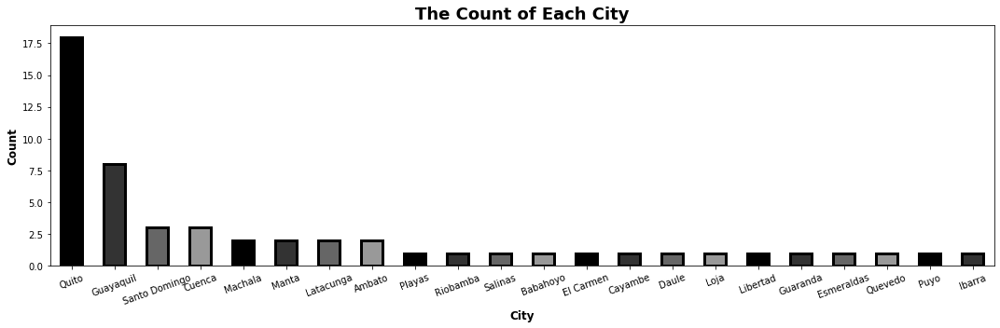

In [99]:
import matplotlib.pyplot as plt

# Define color palette
palette_color = [(0, 0, 0), (0.2, 0.2, 0.2), (0.4, 0.4, 0.4), (0.6, 0.6, 0.6)]

# Create a bar plot
plt.figure(figsize=(15, 5))
ax = stores['city'].value_counts().plot(kind='bar', color=palette_color, edgecolor='black', linewidth=3)

# Customize labels and title
plt.xlabel('City', weight='bold', fontsize='large')
plt.ylabel('Count', weight='bold', fontsize='large')
plt.title('The Count of Each City', weight='bold', fontsize=18, pad=7)
plt.xticks(rotation=20)
plt.tight_layout()

# Show plot
plt.show()


In [101]:
#### Variation ratio of the city

In [100]:
frequency_table_city=stores["city"].value_counts()
frequency_table_city_values=frequency_table_city.values
majority_city=frequency_table_city_values.max()
n=frequency_table_city_values.sum()
print(f"the count of the most frequent  value in city feature is: {majority_city}")
print(f"the count of all values in city feature is: {n}")
variation_ratio_city=np.round(1-majority_city/n,4)
print(f"the variation ratio of city column is: {variation_ratio_city}")

the count of the most frequent  value in city feature is: 18
the count of all values in city feature is: 54
the variation ratio of city column is: 0.6667


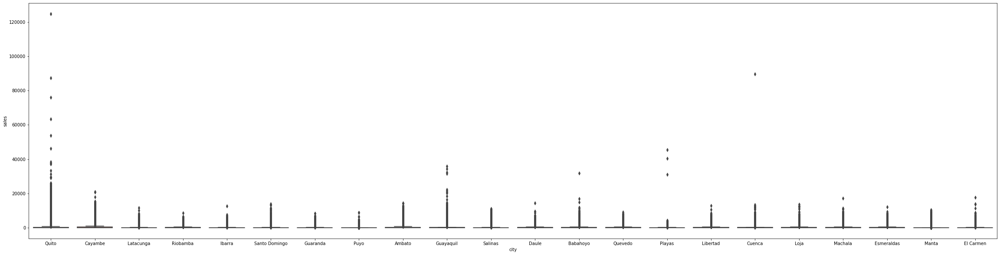

In [102]:
plt.figure(figsize=(40,10))
sns.boxplot(x="city",y="sales",data=train_set)
plt.show()

In [103]:
train_set["year"] = train_set.date.dt.year
a=train_set.groupby(["city","year"],as_index=False).sales.mean()

plot=px.line(data_frame=a,
        x="year",
        y="sales",
        color="city",
        title="daily total sales each city"
       )
train_set.drop(["year"],axis=1,inplace=True)
plot

In [104]:
stores["state"].value_counts()

Pichincha                         19
Guayas                            11
Azuay                              3
Manabi                             3
Santo Domingo de los Tsachilas     3
Tungurahua                         2
Cotopaxi                           2
Los Rios                           2
El Oro                             2
Chimborazo                         1
Loja                               1
Santa Elena                        1
Bolivar                            1
Imbabura                           1
Pastaza                            1
Esmeraldas                         1
Name: state, dtype: int64

In [105]:
### Data is unbalanced.

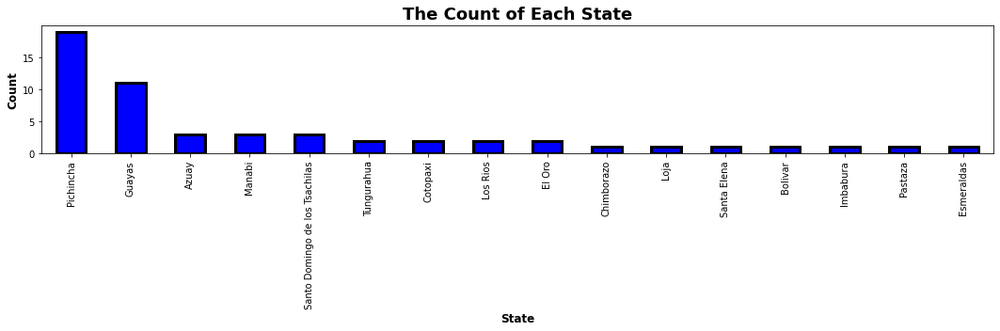

In [107]:
# Create a bar plot
plt.figure(figsize=(15, 5))
ax = stores['state'].value_counts().plot(kind='bar', color="blue", edgecolor='black', linewidth=3)

# Customize labels and title
plt.xlabel('State', weight='bold', fontsize='large')
plt.ylabel('Count', weight='bold', fontsize='large')
plt.title('The Count of Each State', weight='bold', fontsize=18, pad=7)
plt.xticks(rotation=90)
plt.tight_layout()

# Show plot
plt.show()


In [108]:
train_set["year"] = train_set.date.dt.year
a=train_set.groupby(["state","year"],as_index=False).sales.mean()

plot=px.line(data_frame=a,
        x="year",
        y="sales",
        color="state",
        title="daily total sales each state"
       )
train_set.drop(["year"],axis=1,inplace=True)
plot

In [109]:
###variation ratio of state feature

frequency_table_state=stores["state"].value_counts()
frequency_table_state_values=frequency_table_state.values
majority_state=frequency_table_state_values.max()
n=frequency_table_state_values.sum()
print(f"the count of the most frequent  value in state feature is: {majority_state}")
print(f"the count of all values in state feature is: {n}")
variation_ratio_state=np.round(1-majority_state/n,4)
print(f"the variation ratio of state column is: {variation_ratio_state}")

the count of the most frequent  value in state feature is: 19
the count of all values in state feature is: 54
the variation ratio of state column is: 0.6481


In [111]:
###grouping the mean of the sales according to state and city

group_state_city=train_set.groupby(["state","city"],as_index=False)["sales"].agg(
    {"sales_mean":"mean",
     "sales_count":"count",
     "sales_sum":"sum"
    }
).sort_values(by=["sales_mean","sales_count"],ascending=[False,False])

group_state_city.style.set_properties(**{"background-color":"#A2DBFA",
                                                              "color":"black",
                                                              "border":"1.5px solid black"
}).bar(color="#F3F1F5",
       vmin=100_000
      )

,state,city,sales_mean,sales_count,sales_sum
18,Pichincha,Quito,557.243756,1002078,558401708.289968
17,Pichincha,Cayambe,510.319970,55671,28410023.043396
21,Tungurahua,Ambato,362.988224,111342,40415834.792594
6,Guayas,Daule,345.742347,55671,19247822.191534
11,Loja,Loja,339.711245,55671,18912064.699531
12,Los Rios,Babahoyo,319.804148,55671,17803816.726511
4,El Oro,Machala,300.710710,111342,33481731.852552
0,Azuay,Cuenca,295.279021,167013,49315435.164166
5,Esmeraldas,Esmeraldas,295.168255,55671,16432311.947915
7,Guayas,Guayaquil,276.892417,445368,123319021.755532


In [112]:
pivot_state_city = group_state_city[["state","city","sales_mean"]].pivot(index='state',
                                                columns='city')
                                                            
pivot_state_city

sales_mean                                     \
city                                Ambato    Babahoyo    Cayambe      Cuenca   
state                                                                           
Azuay                                  NaN         NaN        NaN  295.279021   
Bolivar                                NaN         NaN        NaN         NaN   
Chimborazo                             NaN         NaN        NaN         NaN   
Cotopaxi                               NaN         NaN        NaN         NaN   
El Oro                                 NaN         NaN        NaN         NaN   
Esmeraldas                             NaN         NaN        NaN         NaN   
Guayas                                 NaN         NaN        NaN         NaN   
Imbabura                               NaN         NaN        NaN         NaN   
Loja                                   NaN         NaN        NaN         NaN   
Los Rios                               NaN  319.804148        NaN         NaN   
Manabi                                 NaN         NaN        NaN         NaN   
Pastaza                                NaN         NaN        NaN         NaN   
Pichincha                              NaN         NaN  510.31997         NaN   
Santa Elena                            NaN         NaN        NaN         NaN   
Santo Domingo de los Tsachilas         NaN         NaN        NaN         NaN   
Tungurahua                      362.988224         NaN        NaN         NaN   

                                                                    \
city                                 Daule   El Carmen  Esmeraldas   
state                                                                
Azuay                                  NaN         NaN         NaN   
Bolivar                                NaN         NaN         NaN   
Chimborazo                             NaN         NaN         NaN   
Cotopaxi                               NaN         NaN         NaN   
El Oro                                 NaN         NaN         NaN   
Esmeraldas                             NaN         NaN  295.168255   
Guayas                          345.742347         NaN         NaN   
Imbabura                               NaN         NaN         NaN   
Loja                                   NaN         NaN         NaN   
Los Rios                               NaN         NaN         NaN   
Manabi                                 NaN  199.214593         NaN   
Pastaza                                NaN         NaN         NaN   
Pichincha                              NaN         NaN         NaN   
Santa Elena                            NaN         NaN         NaN   
Santo Domingo de los Tsachilas         NaN         NaN         NaN   
Tungurahua                             NaN         NaN         NaN   

                                                                  ...  \
city                              Guaranda   Guayaquil    Ibarra  ...   
state                                                             ...   
Azuay                                  NaN         NaN       NaN  ...   
Bolivar                         235.050003         NaN       NaN  ...   
Chimborazo                             NaN         NaN       NaN  ...   
Cotopaxi                               NaN         NaN       NaN  ...   
El Oro                                 NaN         NaN       NaN  ...   
Esmeraldas                             NaN         NaN       NaN  ...   
Guayas                                 NaN  276.892417       NaN  ...   
Imbabura                               NaN         NaN  206.1975  ...   
Loja                                   NaN         NaN       NaN  ...   
Los Rios                               NaN         NaN       NaN  ...   
Manabi                                 NaN         NaN       NaN  ...   
Pastaza                                NaN         NaN       NaN  ...   
Pichincha                              NaN         NaN       NaN  

In [113]:
stores["type"].value_counts()

D    18
C    15
A     9
B     8
E     4
Name: type, dtype: int64

In [118]:
temp = pd.merge(train.groupby(["date","store_nbr"]).sales.sum().reset_index(), 
                transactions,
                how = "left"
               )

print("the Correlation between Total Sales and Transactions: {:,.4f}".format(temp.corr().sales.loc["transactions"]))

px.line(transactions.sort_values(["store_nbr", "date"]), 
        x='date', 
        y='transactions', 
        color='store_nbr',
        title="Transactions" 
       )


the Correlation between Total Sales and Transactions: 0.8374


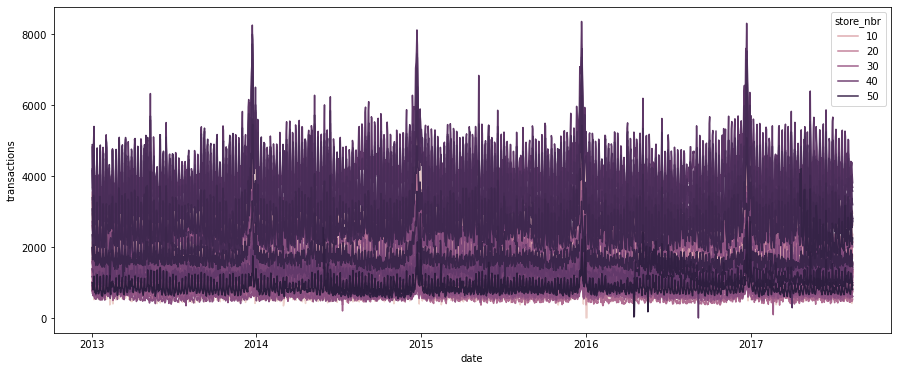

In [119]:
# the same plot using seaborn 
plt.figure(figsize=(15,6))
sns.lineplot(data=transactions.sort_values(["store_nbr", "date"]),
             x="date",
             y="transactions",
             hue="store_nbr",
            )
plt.show()


In [120]:
# Purchases increase every first year
store_3=transactions.sort_values(["store_nbr", "date"])
store_3=store_3[store_3.store_nbr==3]
px.line(data_frame=store_3, 
        x='date', 
        y='transactions', 
        color='store_nbr',
        title="Transactions"
       )

In [121]:
#### There is a stable pattern in Transaction. All months are similar except December from 2013 to 2017 by boxplot.

In [122]:
a = transactions.copy()
a["year"] = a.date.dt.year
a["month"] = a.date.dt.month_name()
px.box(a, 
       x="year",
       y="transactions" , 
       color = "month",
       title = "Transactions"
      )

In [123]:
#### Let's take a look at transactions by using monthly average sales! We've just learned a pattern what increases sales. 
#### It was the end of the year. We can see that transactions increase in spring and decrease after spring.
a = transactions.set_index("date").resample("M").transactions.mean().reset_index()
a["year"] = a.date.dt.year
px.line(data_frame=a, 
        x='date',
        y='transactions',
        color='year',
        title = "Monthly Average Transactions"
       )

In [124]:
#### When we look at their relationship, we can see that there is a highly correlation between total sales and transactions also.

px.scatter(temp, 
           x = "transactions",
           y = "sales",
           trendline = "ols", 
           trendline_color_override = "red"
          )

In [125]:
#### The days of week is very important for shopping. It shows us a great pattern. Stores make more transactions at weekends. 
### Almost, the patterns are same from 2013 to 2017 and Saturday is the most important day for shopping.

a = transactions.copy()
a["year"] = a.date.dt.year
a["dayofweek"] = a.date.dt.dayofweek+1
a = a.groupby(["year", "dayofweek"]).transactions.mean().reset_index()
px.line(a, 
        x="dayofweek",
        y="transactions" ,
        color = "year",
        title = "Transactions"
       )


#### sales

In [126]:
a=train_set.groupby(["date","store_nbr"],as_index=False).sales.mean()
px.line(data_frame=a,
        x="date",
        y="sales",
        color="store_nbr",
        title="Daily total sales of the stors"
       )

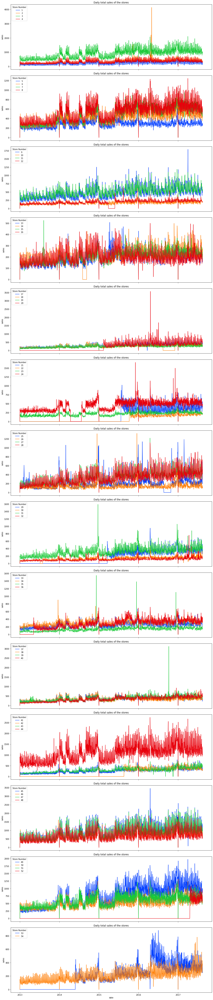

In [127]:
number_of_stores = train.store_nbr.nunique()
stores = sorted(train.store_nbr.unique())
number_of_rows = -(-number_of_stores // 4)  # Ceiling division to calculate number of rows

fig, axes = plt.subplots(nrows=number_of_rows, ncols=1, sharex=True, figsize=(15, 5*number_of_rows))

for i, ax in enumerate(axes.flatten()):
    arr = stores[i*4:(i+1)*4]  # Slicing stores in groups of 4
    df = train_set.groupby(["date", "store_nbr"], as_index=False).sales.mean().query("store_nbr in @arr")
    sns.lineplot(data=df, x="date", y="sales", hue="store_nbr", ax=ax, palette='bright')
    ax.set_title("Daily total sales of the stores")
    ax.legend(title='Store Number', loc='upper left')

plt.tight_layout()
plt.show()

In [128]:
#### I realized some unnecessary rows in the data while I was looking at the time serie of the stores one by one. 
####If you select the stores from above, some of them have no sales at the beginning of 2013.
### You can see them, if you look at the those stores 20, 21, 22, 29, 36, 42, 52 and 53. 
### I decided to remove those rows before the stores opened. i will remove them above

print(train.shape)

# Define conditions for filtering out rows
conditions = (
    ((train.store_nbr == 52) & (train.date < "2017-04-20")) |
    ((train.store_nbr == 22) & (train.date < "2015-10-09")) |
    ((train.store_nbr == 42) & (train.date < "2015-08-21")) |
    ((train.store_nbr == 21) & (train.date < "2015-07-24")) |
    ((train.store_nbr == 29) & (train.date < "2015-03-20")) |
    ((train.store_nbr == 20) & (train.date < "2015-02-13")) |
    ((train.store_nbr == 53) & (train.date < "2014-05-29")) |
    ((train.store_nbr == 36) & (train.date < "2013-05-09"))
)

# Filter the DataFrame using the combined conditions
train = train[~conditions]

print(train.shape)


(3000888, 11)
(2780316, 11)


In [129]:
print(train_set.shape)

# Define the conditions for filtering out rows
conditions = (
    ((train_set.store_nbr == 52) & (train_set.date < "2017-04-20")) |
    ((train_set.store_nbr == 22) & (train_set.date < "2015-10-09")) |
    ((train_set.store_nbr == 42) & (train_set.date < "2015-08-21")) |
    ((train_set.store_nbr == 21) & (train_set.date < "2015-07-24")) |
    ((train_set.store_nbr == 29) & (train_set.date < "2015-03-20")) |
    ((train_set.store_nbr == 20) & (train_set.date < "2015-02-13")) |
    ((train_set.store_nbr == 53) & (train_set.date < "2014-05-29")) |
    ((train_set.store_nbr == 36) & (train_set.date < "2013-05-09"))
)

# Filter the DataFrame using the combined conditions
train_set = train_set[~conditions]

print(train_set.shape)


(3006234, 15)
(2785563, 15)


#### Family

In [130]:
#### Some stores don't sell some product families. In the following code, you can see which products aren't sold in which stores.
#### It isn't difficult to forecast them next 15 days. Their forecasts must be 0 next 15 days.
#### I will remove them from the data and create a new data frame for product families which never sell. 
#### Then, when we are at submission part, I will combine that data frame with our predictions.

c = train_set.groupby(["store_nbr", "family"]).sales.sum().reset_index().sort_values(["family", "store_nbr"])

# Define a conditional style function
def highlight_zero_sales(s):
    return ['background-color: #A2DBFA; color: black; border: 1.5px solid black' if value == 0 else '' for value in s]

# Apply the conditional styling directly to the DataFrame
styled_c = c.style.apply(highlight_zero_sales).bar(color='#F3F1F5', vmin=100_000)

styled_c


In [131]:
print(train_set.shape)

# Anti-join operation
train_set = train_set.merge(c[c.sales == 0].drop("sales", axis=1), how='left', indicator=True)
train_set = train_set[train_set['_merge'] == 'left_only'].drop('_merge', axis=1)

print(train_set.shape)


(2785563, 15)
(2703742, 15)


In [132]:
outer_join = test_set.merge(c.drop("sales", axis=1), how="outer", indicator=True)

# Update 'sales' column based on '_merge' values
outer_join['sales'] = outer_join['_merge'].apply(lambda x: 0 if x == 'both' else 'unknown')

# Rename the '_merge' column to 'sales'
outer_join.rename(columns={"_merge": "sales"}, inplace=True)

test_set = outer_join


In [133]:
##### Some products can sell rarely in the stores.some products are passive if they never bought in the last two months. 
#### I want to apply this domain knowledge here and I will look on the last 60 days.
#### However, some product families depends on seasonality. 
#### Some of them might not active on the last 60 days but it doesn't mean it is passive.

In [134]:
c = train.groupby(["store_nbr", "family"]).tail(60).groupby(["store_nbr", "family"]).sales.sum().reset_index()

# Apply conditional styling directly to DataFrame
styled_c = c[c.sales == 0].style \
    .set_properties(**{"background-color": "#A2DBFA", "color": "black", "border": "1.5px solid black"}) \
    .bar(color="#F3F1F5", vmin=100_000)

styled_c


,store_nbr,family,sales
1,1,1,0.000000
31,1,31,0.000000
34,2,1,0.000000
37,2,4,0.000000
64,2,31,0.000000
70,3,4,0.000000
136,5,4,0.000000
169,6,4,0.000000
196,6,31,0.000000
268,9,4,0.000000


In [135]:
### As we can see below, these examples are too rare and also the sales are low. 


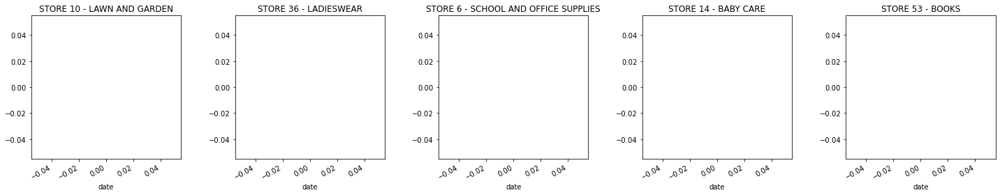

In [136]:
fig, ax = plt.subplots(1, 5, figsize=(20, 4))

# Define store numbers and families
store_family_combinations = [
    (10, "LAWN AND GARDEN"),
    (36, "LADIESWEAR"),
    (6, "SCHOOL AND OFFICE SUPPLIES"),
    (14, "BABY CARE"),
    (53, "BOOKS")
]

# Iterate over store-family combinations
for i, (store_nbr, family) in enumerate(store_family_combinations):
    # Filter data for the current combination and plot
    train[(train.store_nbr == store_nbr) & (train.family == family)].set_index("date").sales.plot(ax=ax[i], title=f"STORE {store_nbr} - {family}")

plt.tight_layout()
plt.show()


In [138]:
c = train_set.groupby(["store_nbr", "family", "date"], as_index=False).agg({"sales": "sum", "transactions": "mean"})

# Apply conditional styling directly to DataFrame
styled_c = c.head().style \
    .set_properties(**{"background-color": "#A2DBFA", "color": "black", "border": "1.5px solid black"}) \
    .bar(color="#F3F1F5", vmin=100_000)

styled_c


,store_nbr,family,date,sales,transactions
0,1,0,2013-01-01 00:00:00,0.000000,nan
1,1,0,2013-01-02 00:00:00,2.000000,2111.000000
2,1,0,2013-01-03 00:00:00,3.000000,1833.000000
3,1,0,2013-01-04 00:00:00,3.000000,1863.000000
4,1,0,2013-01-05 00:00:00,5.000000,1509.000000


In [137]:
a = train.set_index("date").groupby("family").resample("D").sales.mean().reset_index()
px.line(a,
        x = "date",
        y= "sales",
        color = "family", 
        title = "Daily total sales of the family"
       )

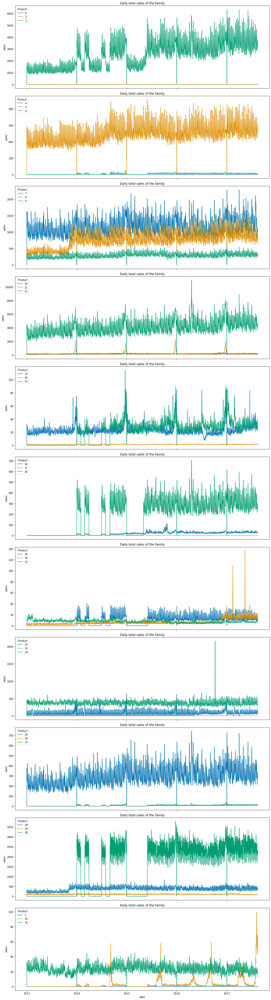

In [141]:
import matplotlib.pyplot as plt

number_of_families = train_set.family.nunique()
families = train_set.family.unique()
number_of_rows = (number_of_families + 2) // 3  # Calculate the number of rows required

fig, axes = plt.subplots(nrows=number_of_rows, ncols=1, sharex=True, figsize=(15, 5 * number_of_rows))

for i, ax in enumerate(axes.flatten()):
    arr = families[i * 3: (i + 1) * 3]  # Slicing families in groups of 3
    df = train_set.set_index("date").groupby("family").resample("D").sales.mean().reset_index().query("family in @arr")
    sns.lineplot(data=df, x="date", y="sales", hue="family", ax=ax, palette="colorblind")
    ax.set_title("Daily total sales of the family")
    ax.legend(title="Product", loc='upper left')

plt.tight_layout()
plt.show()


In [139]:
px.line(a[a.family=="HARDWARE"],
        x = "date",
        y= "sales",
        color = "family", 
        title = "Daily total sales of the family"
       )

In [142]:
##### We are working with the stores. Well, there are plenty of products in the stores and we need to know which 
##### product family sells much more? Let's make a barplot to see that.
##### The graph shows us GROCERY I and BEVERAGES are the top selling families.

In [143]:
a = train.groupby("family").sales.mean().sort_values(ascending = False).reset_index()
px.bar(a,
       y = "family",
       x="sales",
       color = "family",
       title = "Which product family preferred more?"
      )

In [144]:
train_set.drop(["transactions"],axis=1,inplace=True)
test_set.drop(["transactions"],axis=1,inplace=True)

In [145]:
styled_train_set = train_set.head().style \
    .set_properties(**{"background-color": "#A2DBFA", "color": "black", "border": "1.5px solid black"}) \
    .bar(color="#F3F1F5", vmin=100_000)

styled_train_set


,store_nbr,family,sales,onpromotion,month,day,day_of_week,weekend,city,state,type,cluster,date,dcoilwtico
0,1,0,0.000000,0,1,1,1,0,Quito,Pichincha,D,13,2013-01-01 00:00:00,93.140000
2,1,2,0.000000,0,1,1,1,0,Quito,Pichincha,D,13,2013-01-01 00:00:00,93.140000
3,1,3,0.000000,0,1,1,1,0,Quito,Pichincha,D,13,2013-01-01 00:00:00,93.140000
4,1,4,0.000000,0,1,1,1,0,Quito,Pichincha,D,13,2013-01-01 00:00:00,93.140000
5,1,5,0.000000,0,1,1,1,0,Quito,Pichincha,D,13,2013-01-01 00:00:00,93.140000


In [151]:
missing_train=train_set.isna().sum().sum()
missing_test=test_set.isna().sum().sum()
print(f"the number of missing values in train data is: {missing_train}")
print(f"the number of missing values in test data is: {missing_test}")

the number of missing values in train data is: 0
the number of missing values in test data is: 0


In [152]:
def check_same_features(train, test):
    if train.columns.equals(test.columns):
        return True
    else:
        return False

print(check_same_features(train_set, test_set))


False


In [153]:
train_set.drop_duplicates(inplace=True)
test_set.drop_duplicates(inplace=True)